## Creamos la muestra de nuestro dataset

In [5]:
import numpy as np
import pandas as pd
import seaborn as sns
import os
import shutil
import random

In [6]:
# Ruta del dataset completo (con subcarpetas por raza)
ruta_origen = r"C:\Users\marij\Documents\dataset ML"

# Ruta donde guardarás la muestra
ruta_destino = r"C:\Users\marij\Documents\GitHub\repositorio_clase\Project_Break_II_ML\ML_MariaJoseCamacho\src\data_sample"

# Número de imágenes que quieres en la muestra
num_imagenes_muestra = 50  # Ajusta este número si quieres más o menos

# Crear la carpeta destino si no existe
os.makedirs(ruta_destino, exist_ok=True)

# Buscar todas las imágenes .png en subcarpetas del dataset
imagenes_totales = []
for root, dirs, files in os.walk(ruta_origen):
    for file in files:
        if file.lower().endswith('.png'):
            ruta_completa = os.path.join(root, file)
            imagenes_totales.append(ruta_completa)

# Seleccionar imágenes aleatorias
muestra = random.sample(imagenes_totales, min(num_imagenes_muestra, len(imagenes_totales)))

# Copiar las imágenes seleccionadas a la carpeta de muestra con nuevo nombre para evitar duplicados
for i, ruta_img in enumerate(muestra):
    nombre_destino = f"sample_{i+1}.png"
    shutil.copy2(ruta_img, os.path.join(ruta_destino, nombre_destino))

print(f"✅ Muestra creada correctamente con {len(muestra)} imágenes en:\n{ruta_destino}")

✅ Muestra creada correctamente con 50 imágenes en:
C:\Users\marij\Documents\GitHub\repositorio_clase\Project_Break_II_ML\ML_MariaJoseCamacho\src\data_sample


In [7]:
import os
import cv2
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from scipy.stats import skew, kurtosis

Número total de imágenes en el dataset: 670


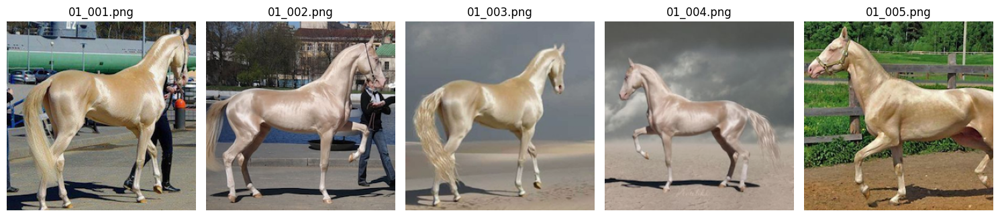

In [8]:
import matplotlib.image as mpimg

DATASET_DIR = r'C:\Users\marij\Documents\dataset ML'

# Listar todas las imágenes en la carpeta dataset
images = [f for f in os.listdir(DATASET_DIR) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

print(f"Número total de imágenes en el dataset: {len(images)}")

# Mostrar algunas imágenes ejemplo
num_ejemplos = 5
fig, axes = plt.subplots(1, num_ejemplos, figsize=(15, 5))

for i, ax in enumerate(axes):
    img_path = os.path.join(DATASET_DIR, images[i])
    img = mpimg.imread(img_path)
    ax.imshow(img)
    ax.set_title(images[i])
    ax.axis('off')

plt.tight_layout()
plt.show()

In [9]:
# Tamaño fijo para redimensionar las imágenes
IMG_SIZE = (128, 128)

imagenes_aplanadas = []

for img_name in images:
    img_path = os.path.join(DATASET_DIR, img_name)
    # Leer imagen en escala de grises con OpenCV
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    # Redimensionar
    img_resized = cv2.resize(img, IMG_SIZE)
    # Aplanar
    img_flat = img_resized.flatten()
    imagenes_aplanadas.append(img_flat)

# Crear DataFrame
df = pd.DataFrame(imagenes_aplanadas)

# Reordenar aleatoriamente para evitar sesgos
df = df.sample(frac=1, random_state=42).reset_index(drop=True)

print(f"DataFrame con {df.shape[0]} imágenes y {df.shape[1]} features (pixeles aplanados)")
df.head()

DataFrame con 670 imágenes y 16384 features (pixeles aplanados)


,0,1,2,3,4,5,6,7,8,9,...,16374,16375,16376,16377,16378,16379,16380,16381,16382,16383
0,229,229,229,229,229,229,229,229,229,229,...,233,233,235,234,233,235,233,236,234,235
1,201,201,201,201,201,201,201,201,201,201,...,158,155,159,161,154,151,159,154,143,150
2,247,247,247,247,247,247,247,247,247,247,...,255,255,255,255,255,255,255,255,255,255
3,245,245,245,245,245,245,245,245,245,245,...,180,185,183,187,189,192,187,182,185,191
4,255,255,255,255,255,255,255,255,255,255,...,255,255,255,255,255,255,255,255,255,255


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 670 entries, 0 to 669
Columns: 16384 entries, 0 to 16383
dtypes: uint8(16384)
memory usage: 10.5 MB


In [11]:
df.shape

(670, 16384)

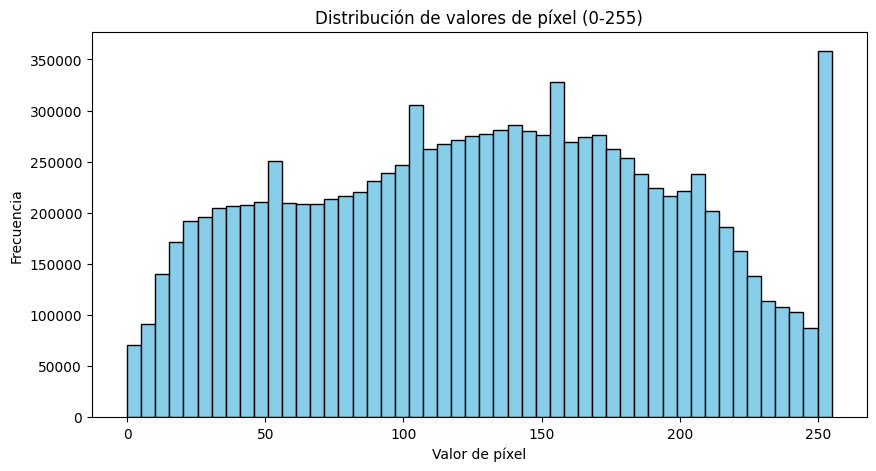

In [12]:
# 2. Visualización de la distribución general de brillo con un histograma
plt.figure(figsize=(10, 5))
plt.hist(df.values.flatten(), bins=50, color='skyblue', edgecolor='black')
plt.title('Distribución de valores de píxel (0-255)')
plt.xlabel('Valor de píxel')
plt.ylabel('Frecuencia')
plt.show()

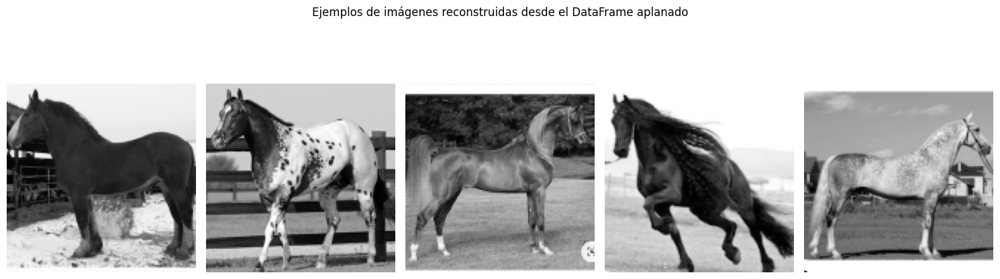

In [13]:
# Visualización de las imágenes aplanadas

def mostrar_imagen_reconstruida(row, img_shape=(128, 128)):
    img = row.values.reshape(img_shape)
    plt.imshow(img, cmap='gray')
    plt.axis('off')

plt.figure(figsize=(15, 5))
for i in range(5):
    plt.subplot(1, 5, i+1)
    mostrar_imagen_reconstruida(df.iloc[i])
plt.suptitle('Ejemplos de imágenes reconstruidas desde el DataFrame aplanado')
plt.tight_layout()
plt.show()

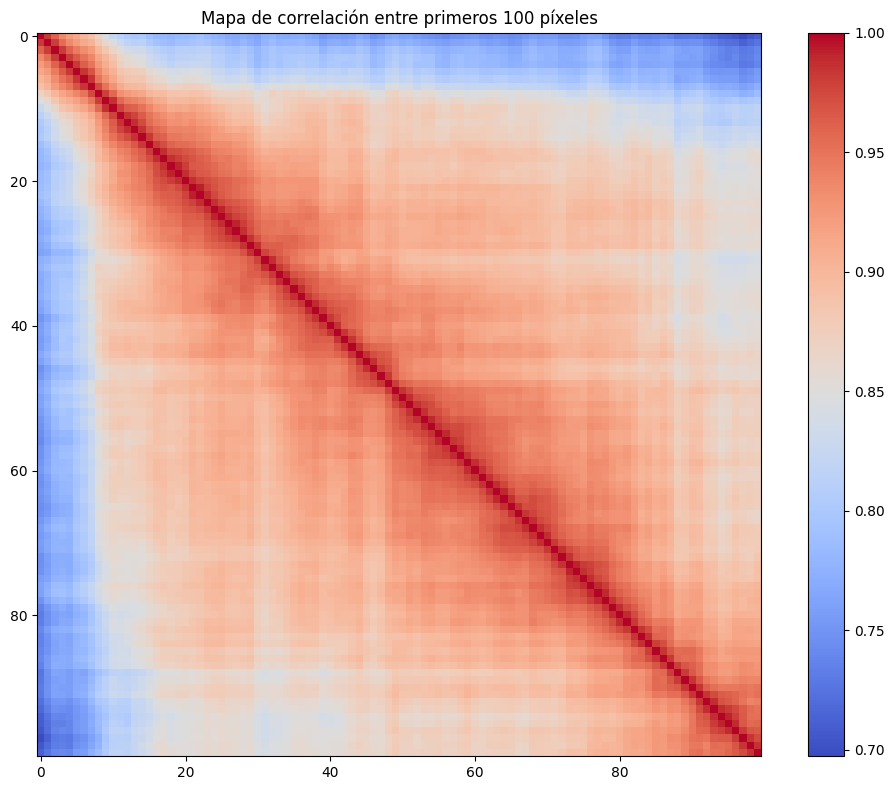

In [14]:
# Correlacion entre pixeles (100 primeros)
corr_subset = df.iloc[:, :100].corr()
plt.figure(figsize=(10, 8))
plt.imshow(corr_subset, cmap='coolwarm', interpolation='none')
plt.colorbar()
plt.title('Mapa de correlación entre primeros 100 píxeles')
plt.tight_layout()
plt.show()

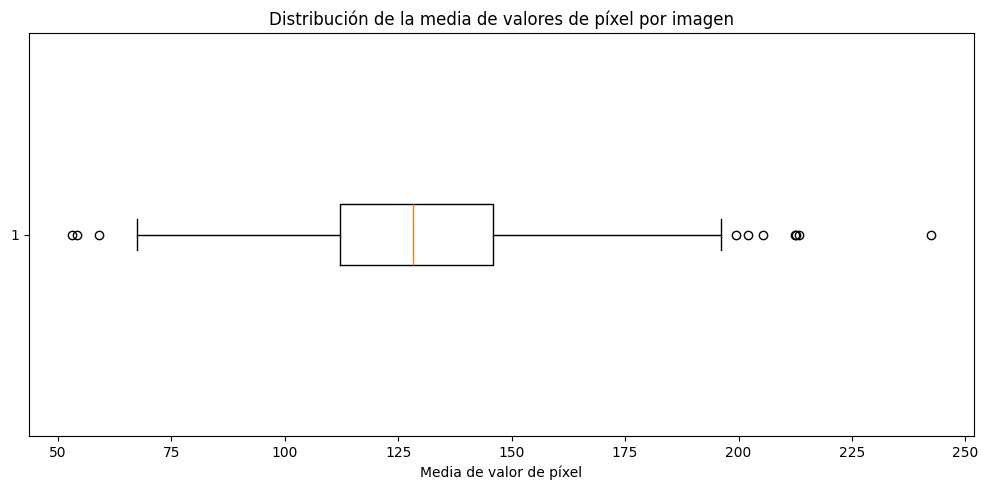

count    670.000000
mean     129.220992
std       25.658030
min       52.978088
25%      112.082794
50%      128.258850
75%      145.917831
max      242.435425
dtype: float64


In [15]:
# imagenes con valores anomalos

media_pixeles_por_imagen = df.mean(axis=1)
plt.figure(figsize=(10, 5))
plt.boxplot(media_pixeles_por_imagen, vert=False)
plt.title('Distribución de la media de valores de píxel por imagen')
plt.xlabel('Media de valor de píxel')
plt.tight_layout()
plt.show()

print(media_pixeles_por_imagen.describe())

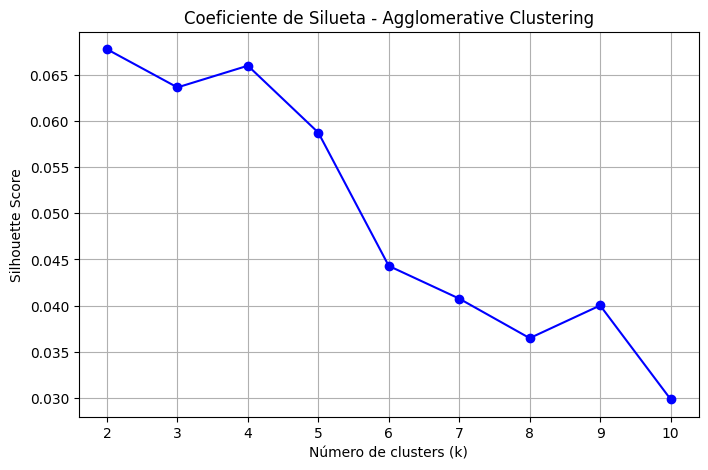

In [17]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import numpy as np
from sklearn.preprocessing import StandardScaler

# Escalado de los datos antes de PCA
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df)

# Rango de valores k a probar
K_range = range(2, 11)
silhouette_scores = []

for k in K_range:
    agg = AgglomerativeClustering(n_clusters=k)
    labels = agg.fit_predict(df_scaled)
    score = silhouette_score(df_scaled, labels)
    silhouette_scores.append(score)

# Visualizar resultados
plt.figure(figsize=(8,5))
plt.plot(K_range, silhouette_scores, 'bo-')
plt.title('Coeficiente de Silueta - Agglomerative Clustering')
plt.xlabel('Número de clusters (k)')
plt.ylabel('Silhouette Score')
plt.grid(True)
plt.show()

In [21]:
# Convertir DataFrame a numpy array
imagenes_aplanadas_array = df.values  # (n_imágenes, 16384)

# Reconstruir imágenes 2D (128x128)
imagenes_2d = imagenes_aplanadas_array.reshape(-1, 128, 128)  # (n_imágenes, 128, 128)

In [22]:
# 1. Aplica clustering (ejemplo Agglomerative con k=3)
from sklearn.cluster import AgglomerativeClustering

k = 3
agg = AgglomerativeClustering(n_clusters=k)
labels = agg.fit_predict(df_scaled)  # df_scaled: tus datos escalados (features)

# 2. Ahora tienes las etiquetas de cluster en 'labels'

# 3. Visualiza imágenes agrupadas con función preparada:
def plot_images_with_clusters(images, labels, img_shape=(128,128), n_cols=5):
    images = images.reshape(-1, img_shape[0], img_shape[1])
    n_rows = (len(images) - 1) // n_cols + 1
    plt.figure(figsize=(n_cols * 3, n_rows * 3))
    for idx, (img, label) in enumerate(zip(images, labels)):
        plt.subplot(n_rows, n_cols, idx + 1)
        plt.imshow(img, cmap='gray')
        plt.axis('off')
        plt.title(f'Cluster {label}')
    plt.tight_layout()
    plt.show()

# 4. Usa la función con tu array de imágenes original y las etiquetas que obtuviste
plot_images_with_clusters(imagenes_2d, labels, img_shape=(128,128), n_cols=5)
